In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install -q tfimm
!pip3 install -q timm==0.6.13
!pip3 install tensorflow-addons
!pip3 install numba

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [1]:
import sys, os, glob, pathlib, shap, warnings, tfimm, shutil, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from tensorflow_addons.optimizers import AdamW

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_ViT, display_gradcam
from distillation_ViT import DeiT, ViTDistilled
from distillation import Distiller
from student_vit import StudentViT
from occlusion_maps import OcclusionMaps
from rise import RISE



TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.10.0 and strictly below 2.13.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/a

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<h1>Load Dataset</h1>

In [ ]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v5.zip'

In [ ]:
for url in glob.glob('/content/dataset_CD_UC/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  imsave('/content/dataset_CD_UC/ulcerative-colitis/'+url.split('/')[4], img)

In [ ]:
os.mkdir('/content/frames/frames_train')
os.mkdir('/content/frames/frames_test')

os.mkdir('/content/frames/frames_train/crohn-disease')
os.mkdir('/content/frames/frames_train/ulcerative-colitis')

os.mkdir('/content/frames/frames_test/crohn-disease')
os.mkdir('/content/frames/frames_test/ulcerative-colitis')

In [ ]:
for url in glob.glob('/content/frames-crop/*.jpg'):
  img = imread(url)
  imsave('/content/frames/frames_test/ulcerative-colitis/'+url.split('/')[3], img)


list_files = [name for name in glob.glob('/content/frames/ulcerative-colitis/*.jpg')]
for a in list_files:
  shutil.move(a, '/content/frames/frames_train/ulcerative-colitis/')

In [ ]:
os.rmdir(pathlib.Path('/content/frames/ulcerative-colitis'))
!rm -r '/content/dataset_CD_UC/ulcerative-colitis-crop/'
!rm -r '/content/frames-crop/'

In [2]:
data_dir = pathlib.Path('/content/dataset_CD_UC')
data_dir_frames_train = pathlib.Path('/content/frames/frames_train')
data_dir_frames_test = pathlib.Path('/content/frames/frames_test')

# Input size initial
batch_size = 32
IMG_SIZE = (224, 224)

# Distillation
BASE_LR = 1e-5
WEIGHT_DECAY = 0.0001
lr_scaled = (BASE_LR / 512) * batch_size

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2649 files belonging to 2 classes.
Using 795 files for training.
Found 2649 files belonging to 2 classes.
Using 794 files for validation.
['crohn-disease', 'ulcerative-colitis']


In [3]:
frames_train = image_dataset_from_directory(data_dir_frames_train,image_size=IMG_SIZE,batch_size=batch_size)
frames_test = image_dataset_from_directory(data_dir_frames_test,image_size=IMG_SIZE,batch_size=batch_size)

train_ds = train_ds.concatenate(frames_train)
test_ds = test_ds.concatenate(frames_test)

Found 34 files belonging to 2 classes.
Found 30 files belonging to 2 classes.


Found 2649 files belonging to 2 classes.


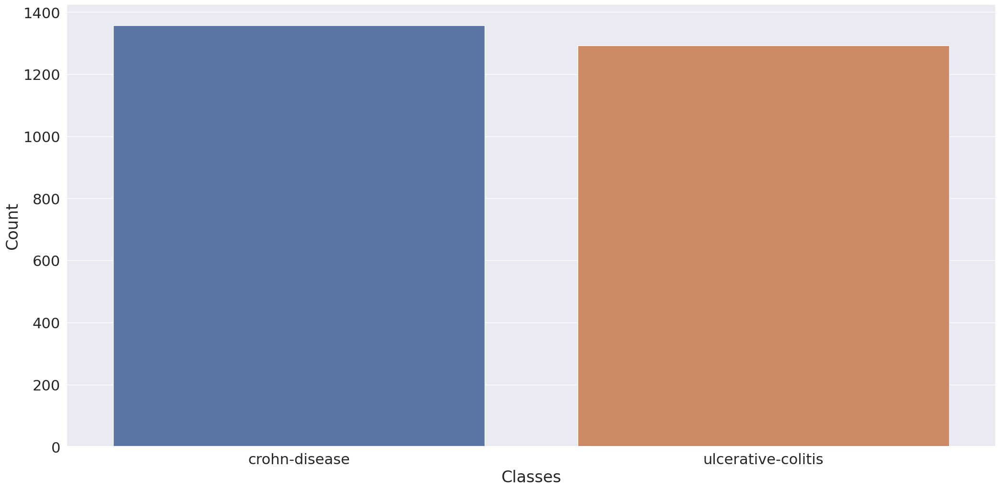

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

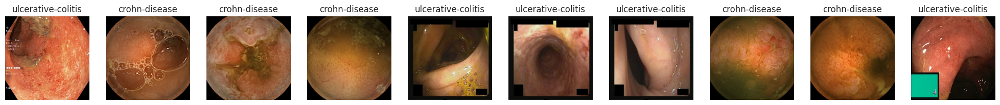

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [4]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [5]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [6]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [7]:
inputs = Input(shape=IMG_SIZE+(3,))
outputs = ViTDistilled().call(inputs)
student_model_1 = Model(inputs, outputs)

student_model_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.compat.v1.shape (TFOpLambda  (4,)                0           ['input_1[0][0]']                
 )                                                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  ()                  0           ['tf.compat.v1.shape[0][0]']     
 ingOpLambda)                                                                                 

In [8]:
inputs = Input(shape=IMG_SIZE+(3,))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
outputs = StudentViT(32).call(x)
student_model_2 = Model(inputs, outputs)

student_model_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['sequential[0][0]']             
                                                                                                  
 patches (Patches)              (None, None, 3072)   0           ['rescaling[0][0]']        

<h1>Images to Interpretability</h1>

In [ ]:
for url in glob.glob('/content/test/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  imsave('/content/test/ulcerative-colitis/'+url.split('/')[4], img)

In [ ]:
!rm -r '/content/test/ulcerative-colitis-crop/'

In [9]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability_2 = np.concatenate(images_exp)
labels_interpretability_2 = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


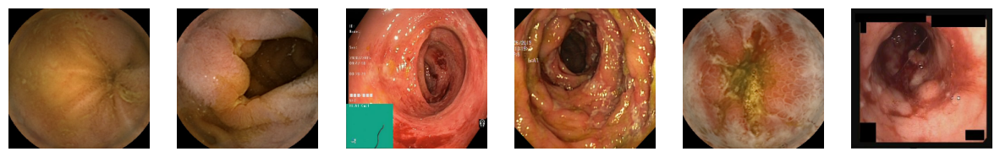

In [10]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [11]:
print('*** Ground truth ***\n')
for val in labels_interpretability_2:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


# ViT_B/32

In [ ]:
vit_model = tfimm.create_model("vit_base_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_preprocessing = tfimm.create_preprocessing("vit_base_patch32_224_in21k")

inputs = Input(shape=(224, 224,3))
x = data_augmentation(inputs)
x = vit_model_preprocessing(x)
x = vit_model.call(x)
outputs = layers.Dense(len(class_names))(x)
model_vit_b32 = Model(inputs, outputs)

In [ ]:
model_vit_b32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_vit_b32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 32s 589ms/step - loss: 0.2714 - accuracy: 0.9119 - val_loss: 0.0424 - val_accuracy: 0.9871
Epoch 2/200
27/27 [==============================] - 14s 491ms/step - loss: 0.0039 - accuracy: 0.9988 - val_loss: 0.0132 - val_accuracy: 0.9945
Epoch 3/200
27/27 [==============================] - 13s 460ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0101 - val_accuracy: 0.9945
Epoch 4/200
27/27 [==============================] - 13s 457ms/step - loss: 7.0967e-04 - accuracy: 1.0000 - val_loss: 0.0193 - val_accuracy: 0.9926
Epoch 5/200
27/27 [==============================] - 13s 474ms/step - loss: 4.2670e-04 - accuracy: 1.0000 - val_loss: 0.0147 - val_accuracy: 0.9945
Epoch 6/200
27/27 [==============================] - 14s 489ms/step - loss: 3.6253e-04 - accuracy: 1.0000 - val_loss: 0.0078 - val_accuracy: 0.9982
Epoch 7/200
27/27 [==============================] - 13s 465ms/step - loss: 4.2320e-04 - accuracy: 1.0000 - val_loss: 0.0087

<Axes: >

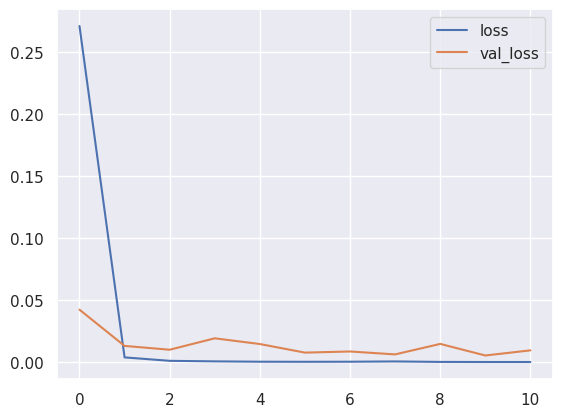

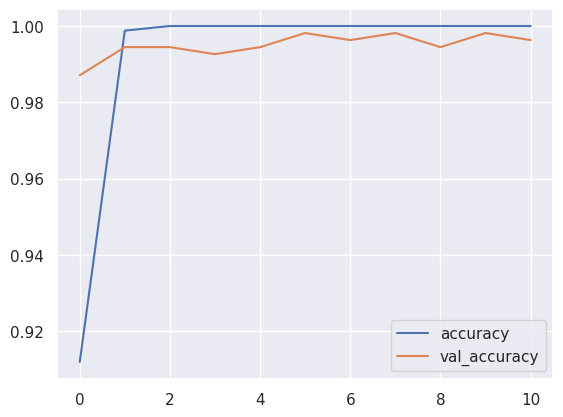

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history['val_loss'].mean()))

Accuracy for Train: 0.9919
Loss for Train: 0.0254
Accuracy for Test: 0.9950
Loss for Test: 0.0139


In [ ]:
start = time.time()
predict_labels_ = model_vit_b32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_vit_b32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 0.9929
Loss: 0.0147
Inference Time: 3.54s
Precision: 0.9926
Recall: 0.9926
F1-Score: 0.9926
AUC: 0.9929
MCC: 0.9858


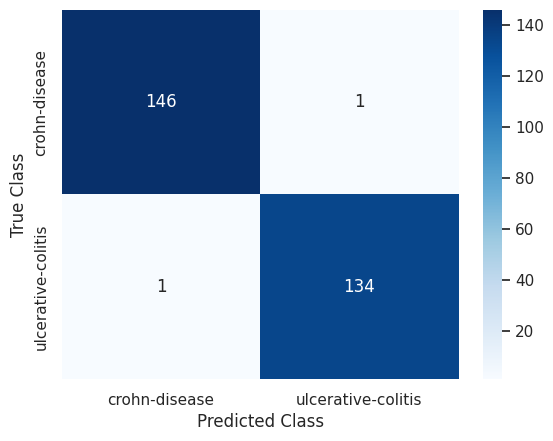

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h2>Knowledge Distillation</h2>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_b32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, batch_size=batch_size, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 18s 278ms/step - accuracy: 0.5199 - student_loss: 1.2796 - distillation_loss: 13.4875 - val_accuracy: 0.5572 - val_student_loss: 0.1238
Epoch 2/100
27/27 [==============================] - 7s 215ms/step - accuracy: 0.5790 - student_loss: 1.2532 - distillation_loss: 11.9987 - val_accuracy: 0.5332 - val_student_loss: 0.1001
Epoch 3/100
27/27 [==============================] - 7s 247ms/step - accuracy: 0.6176 - student_loss: 1.0150 - distillation_loss: 11.1788 - val_accuracy: 0.7860 - val_student_loss: 0.1224
Epoch 4/100
27/27 [==============================] - 7s 233ms/step - accuracy: 0.7901 - student_loss: 0.5914 - distillation_loss: 8.0782 - val_accuracy: 0.9207 - val_student_loss: 0.0492
Epoch 5/100
27/27 [==============================] - 7s 245ms/step - accuracy: 0.9107 - student_loss: 0.2539 - distillation_loss: 3.7633 - val_accuracy: 0.9576 - val_student_loss: 0.0840
Epoch 6/100
27/27 [==============================] - 7s 238ms

<Axes: >

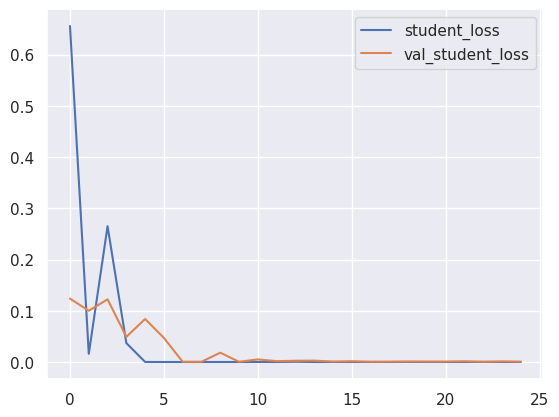

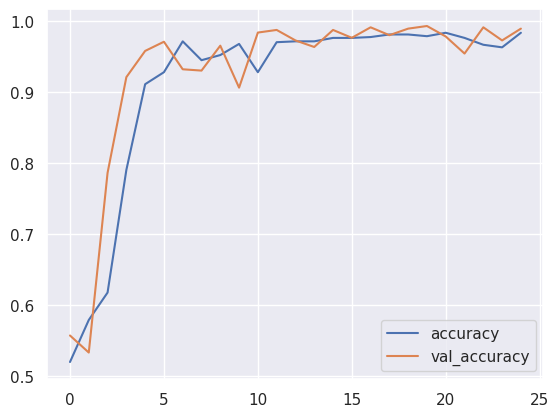

In [ ]:
distiller_history_2 = pd.DataFrame(distillation_history.history)
distiller_history_2.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history_2['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history_2['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history_2['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history_2['val_student_loss'].mean()))

Accuracy for Train: 0.9103
Loss for Train: 0.0390
Accuracy for Test: 0.9265
Loss for Test: 0.0227


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9787
Loss: 0.0522
Inference Time: 1.53s
Precision: 0.9708
Recall: 0.9852
F1-Score: 0.9779
AUC: 0.9790
MCC: 0.9575


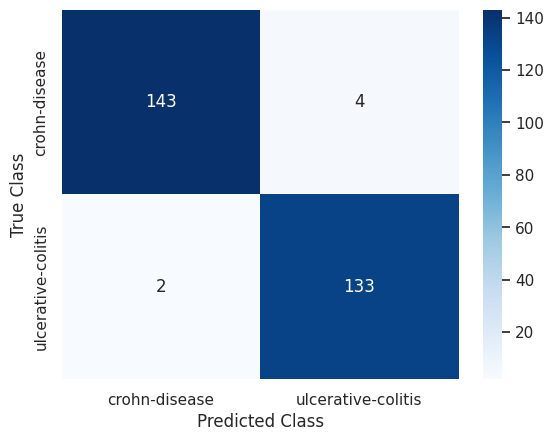

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 34s 417ms/step - accuracy: 0.5428 - student_loss: 0.8259 - distillation_loss: 0.8011 - val_accuracy: 0.6125 - val_student_loss: 0.6334 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 24s 441ms/step - accuracy: 0.6007 - student_loss: 0.7248 - distillation_loss: 0.7248 - val_accuracy: 0.8524 - val_student_loss: 0.5686 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 22s 400ms/step - accuracy: 0.6695 - student_loss: 0.6547 - distillation_loss: 0.6664 - val_accuracy: 0.8672 - val_student_loss: 0.5034 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 24s 439ms/step - accuracy: 0.7159 - student_loss: 0.6182 - distillation_loss: 0.5858 - val_accuracy: 0.9059 - val_student_loss: 0.4239 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 22s 401ms/step - accuracy: 0.7865 - student_loss: 0

<Axes: >

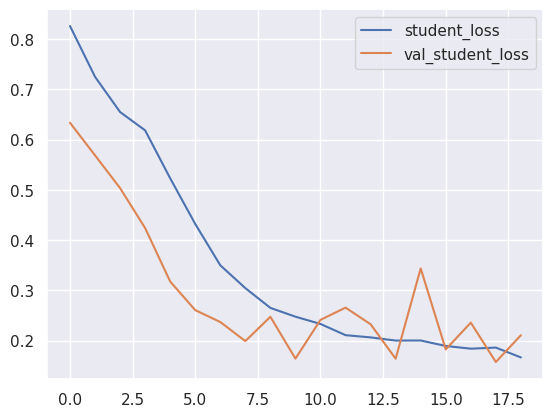

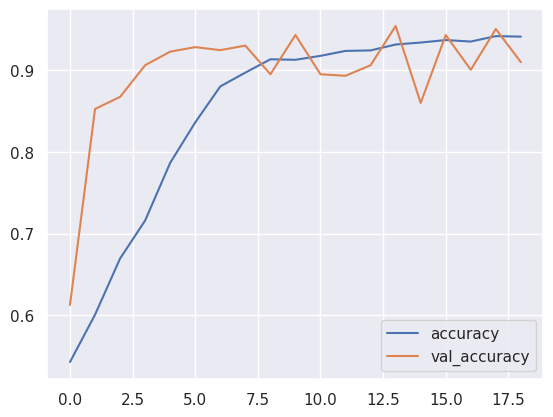

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8493
Loss for Train: 0.3539
Accuracy for Test: 0.8943
Loss for Test: 0.2942


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9255
Loss: 0.1920
Inference Time: 1.60s
Precision: 0.9914
Recall: 0.8519
F1-Score: 0.9163
AUC: 0.9225
MCC: 0.8579


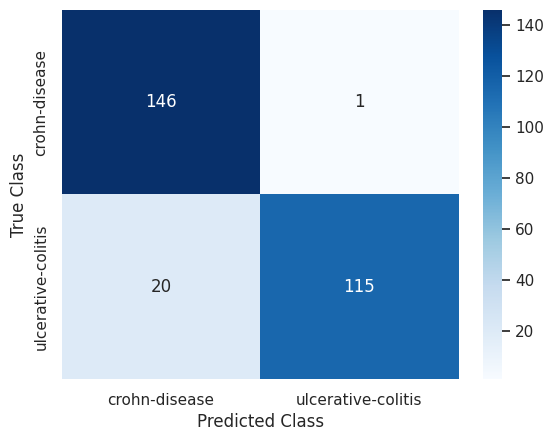

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

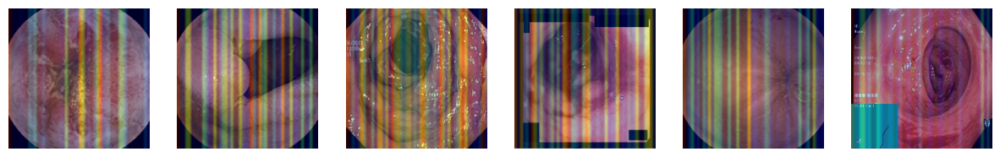

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b32.layers[-1].activation = None

  preds = model_vit_b32.predict(img_array)
  heatmap = make_gradcam_heatmap_ViT(img_array, model_vit_b32, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,50))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

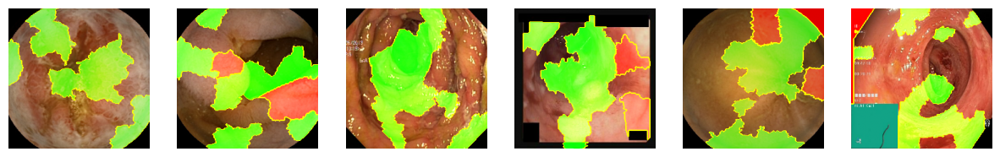

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


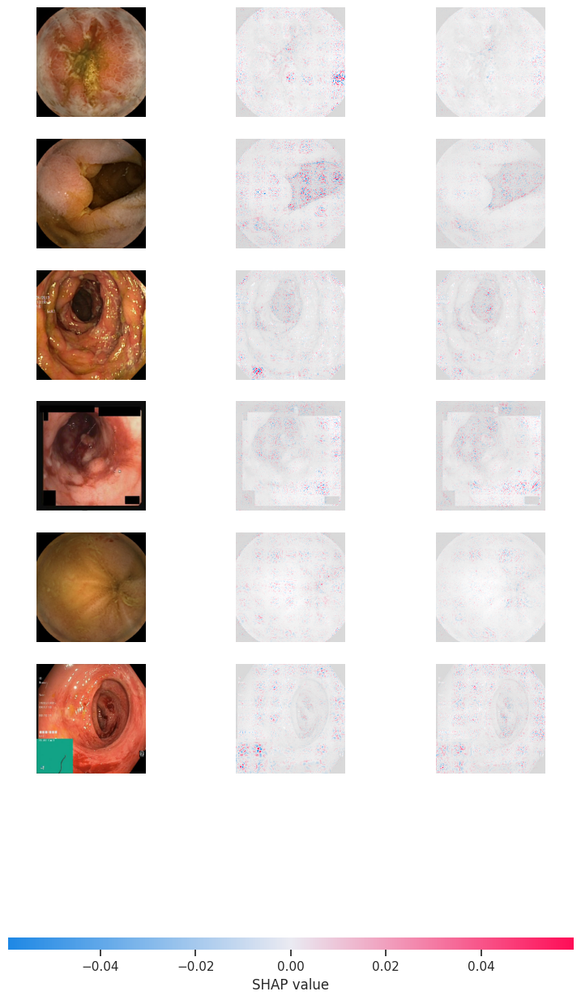

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b32, images_train_1).shap_values(image_interpretability_2)
shap.image_plot(shap_values, image_interpretability_2)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 380.31it/s]


Explaining: 100%|██████████| 32/32 [00:06<00:00,  5.25it/s]


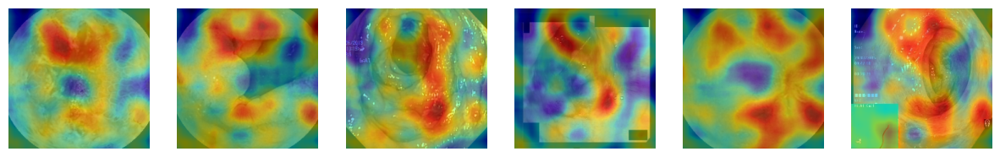

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

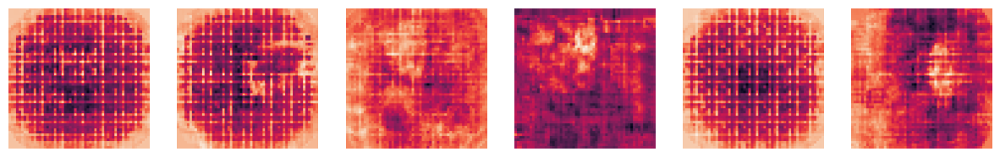

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_b32, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

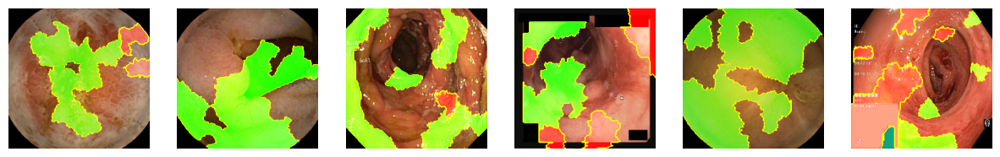

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 382.69it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.95it/s]


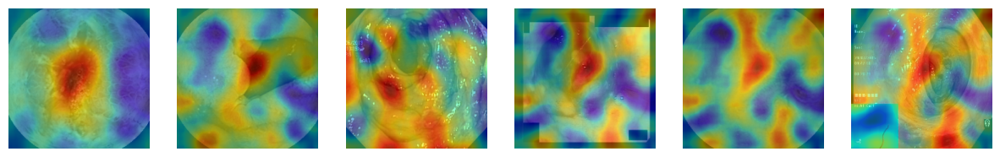

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

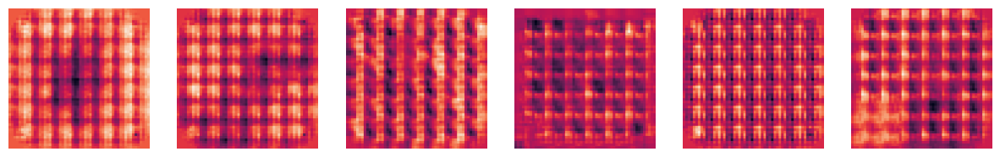

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h2>Interpretability of Second Student</h2>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

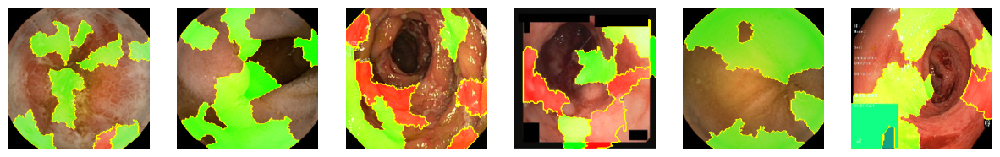

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 236.01it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.45it/s]


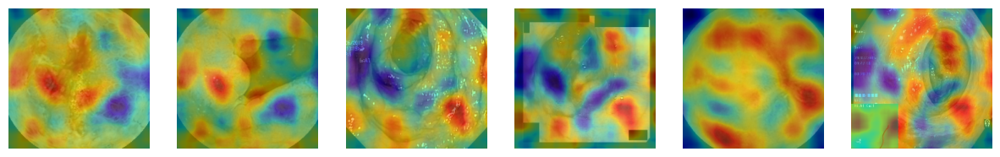

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

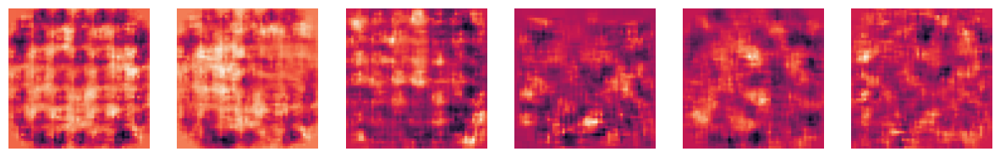

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/32

In [ ]:
vit_model_s32 = tfimm.create_model("vit_small_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_s32_preprocessing = tfimm.create_preprocessing("vit_small_patch32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s32_preprocessing(x)
x = vit_model_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s32 = Model(inputs, outputs)

In [ ]:
model_vit_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s32 = model_vit_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 27s 392ms/step - loss: 0.4383 - accuracy: 0.8938 - val_loss: 0.1398 - val_accuracy: 0.9465
Epoch 2/200
27/27 [==============================] - 9s 302ms/step - loss: 0.0182 - accuracy: 0.9928 - val_loss: 0.0172 - val_accuracy: 0.9963
Epoch 3/200
27/27 [==============================] - 6s 214ms/step - loss: 0.0035 - accuracy: 0.9988 - val_loss: 0.0260 - val_accuracy: 0.9926
Epoch 4/200
27/27 [==============================] - 8s 285ms/step - loss: 0.0025 - accuracy: 0.9988 - val_loss: 0.0101 - val_accuracy: 0.9982
Epoch 5/200
27/27 [==============================] - 6s 220ms/step - loss: 0.0038 - accuracy: 0.9988 - val_loss: 0.0149 - val_accuracy: 0.9945
Epoch 6/200
27/27 [==============================] - 8s 272ms/step - loss: 7.2235e-04 - accuracy: 1.0000 - val_loss: 0.0121 - val_accuracy: 0.9945
Epoch 7/200
27/27 [==============================] - 6s 225ms/step - loss: 0.0012 - accuracy: 1.0000 - val_loss: 0.0055 - val_accuracy: 0

<Axes: >

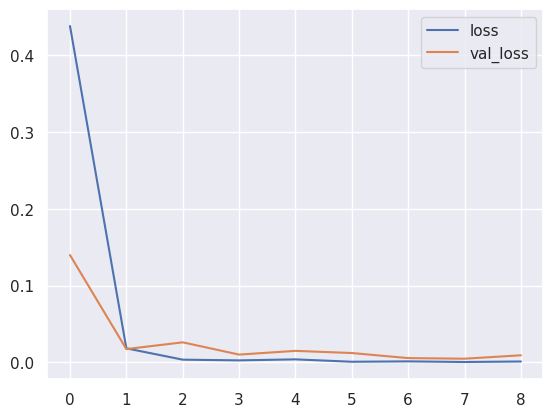

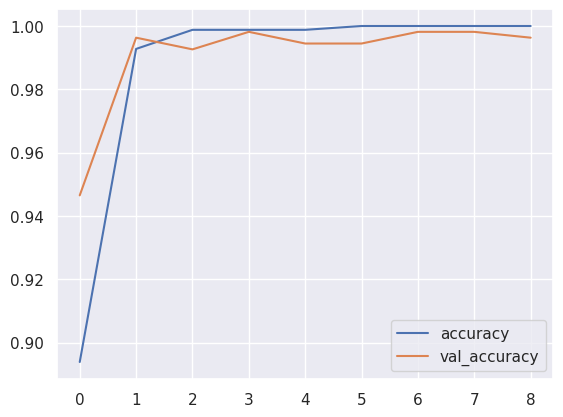

In [ ]:
model_history_s32 = pd.DataFrame(history_s32.history)
model_history_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s32['val_loss'].mean()))

Accuracy for Train: 0.9870
Loss for Train: 0.0522
Accuracy for Test: 0.9906
Loss for Test: 0.0266


In [ ]:
start = time.time()
predict_labels_ = model_vit_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s32 = np.argmax(model_vit_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s32)))

Accuracy: 1.0000
Loss: 0.0070
Inference Time: 4.15s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


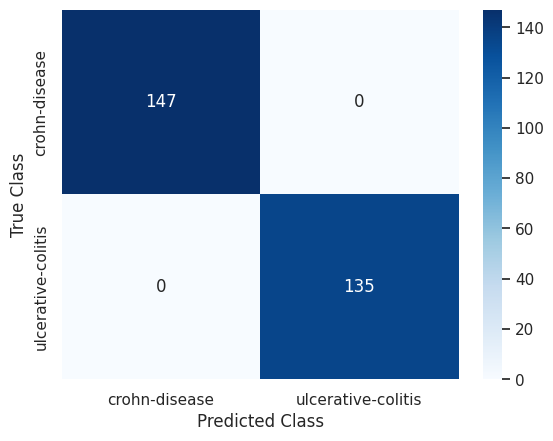

In [ ]:
conf_matrix_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 18s 228ms/step - accuracy: 0.5066 - student_loss: 1.3437 - distillation_loss: 14.7234 - val_accuracy: 0.5185 - val_student_loss: 0.2736
Epoch 2/100
27/27 [==============================] - 5s 156ms/step - accuracy: 0.5476 - student_loss: 1.0447 - distillation_loss: 14.0184 - val_accuracy: 0.5240 - val_student_loss: 0.0940
Epoch 3/100
27/27 [==============================] - 8s 266ms/step - accuracy: 0.6731 - student_loss: 0.7384 - distillation_loss: 11.5185 - val_accuracy: 0.7048 - val_student_loss: 0.0025
Epoch 4/100
27/27 [==============================] - 4s 152ms/step - accuracy: 0.8709 - student_loss: 0.3912 - distillation_loss: 6.1988 - val_accuracy: 0.9151 - val_student_loss: 0.3702
Epoch 5/100
27/27 [==============================] - 5s 158ms/step - accuracy: 0.9300 - student_loss: 0.2239 - distillation_loss: 4.4381 - val_accuracy: 0.7823 - val_student_loss: 2.4157
Epoch 6/100
27/27 [==============================] - 8s 251ms

<Axes: >

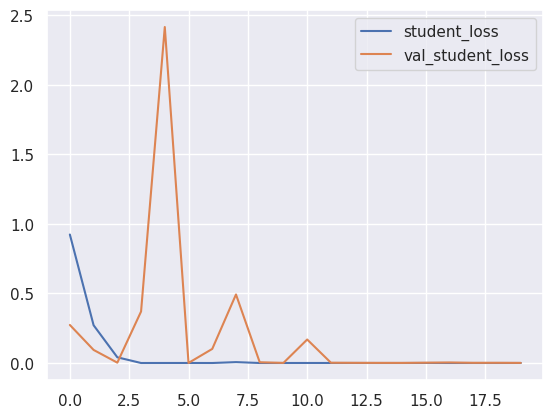

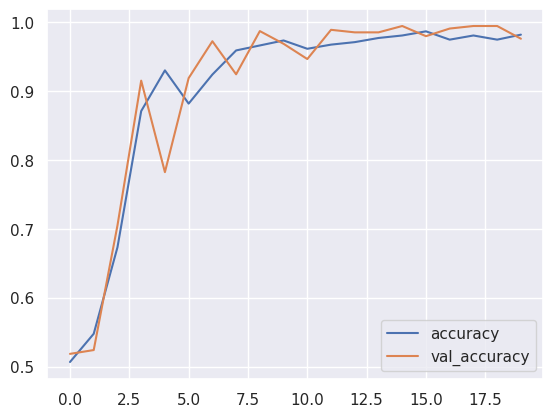

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8995
Loss for Train: 0.0622
Accuracy for Test: 0.9026
Loss for Test: 0.1970


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9645
Loss: 0.1216
Inference Time: 1.04s
Precision: 0.9371
Recall: 0.9926
F1-Score: 0.9640
AUC: 0.9657
MCC: 0.9306


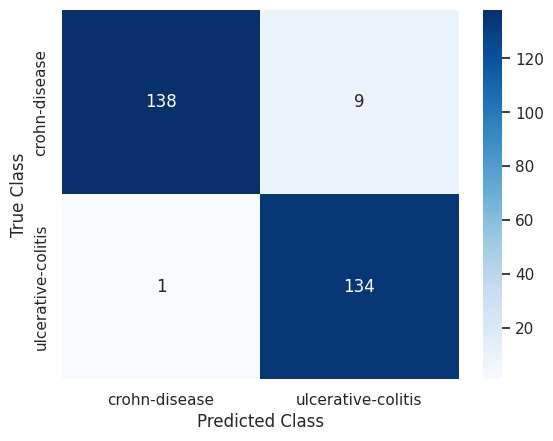

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 30s 364ms/step - accuracy: 0.5573 - student_loss: 0.7598 - distillation_loss: 0.7949 - val_accuracy: 0.7214 - val_student_loss: 0.5725 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 20s 358ms/step - accuracy: 0.6713 - student_loss: 0.6897 - distillation_loss: 0.6627 - val_accuracy: 0.9114 - val_student_loss: 0.4785 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 21s 388ms/step - accuracy: 0.7346 - student_loss: 0.6231 - distillation_loss: 0.5702 - val_accuracy: 0.9077 - val_student_loss: 0.3937 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 19s 355ms/step - accuracy: 0.7877 - student_loss: 0.5260 - distillation_loss: 0.5084 - val_accuracy: 0.9262 - val_student_loss: 0.2972 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 20s 362ms/step - accuracy: 0.8450 - student_loss: 0

<Axes: >

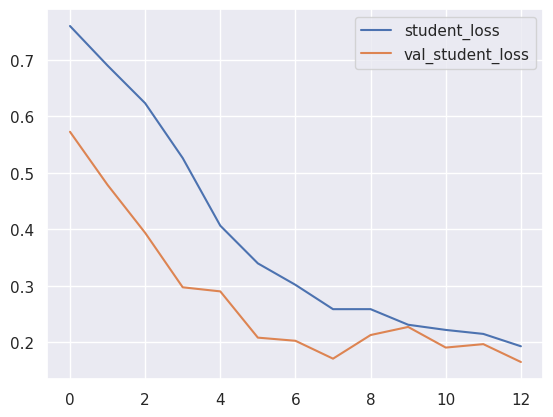

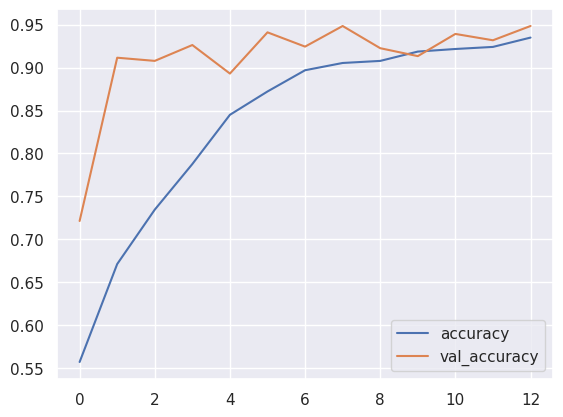

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8367
Loss for Train: 0.3864
Accuracy for Test: 0.9099
Loss for Test: 0.2774


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9362
Loss: 0.1899
Inference Time: 1.15s
Precision: 0.9606
Recall: 0.9037
F1-Score: 0.9313
AUC: 0.9348
MCC: 0.8732


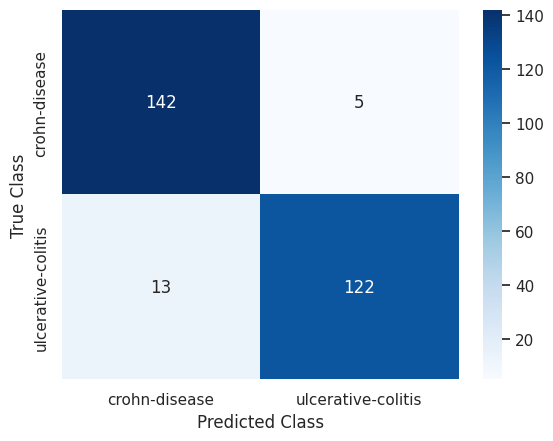

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

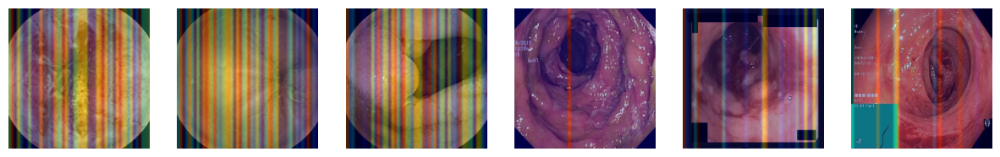

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s32.layers[-1].activation = None

  preds = model_vit_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

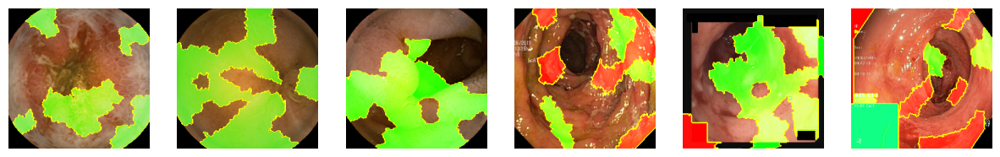

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


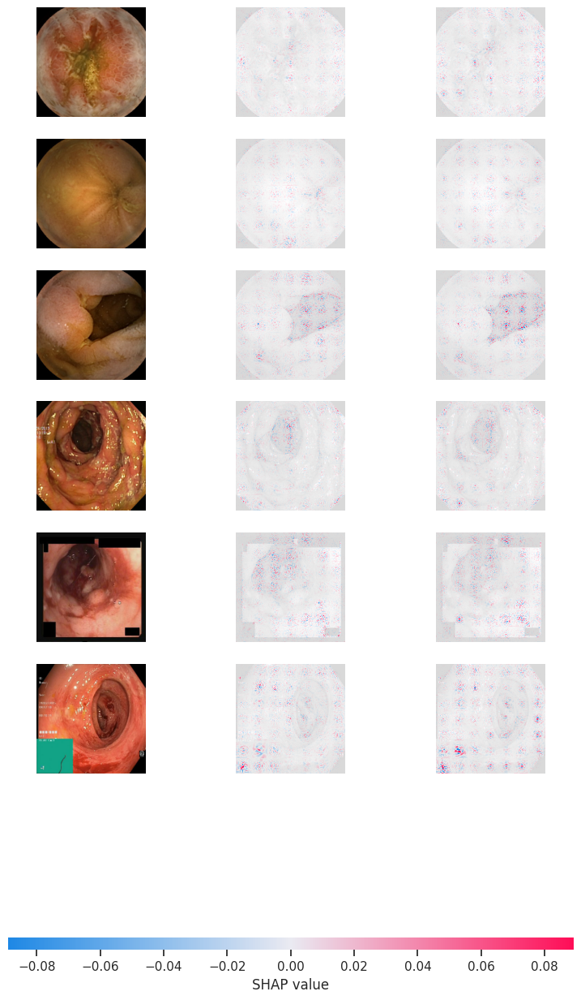

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s32, images_train_1).shap_values(image_interpretability_2)
shap.image_plot(shap_values, image_interpretability_2)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 299.86it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  6.74it/s]


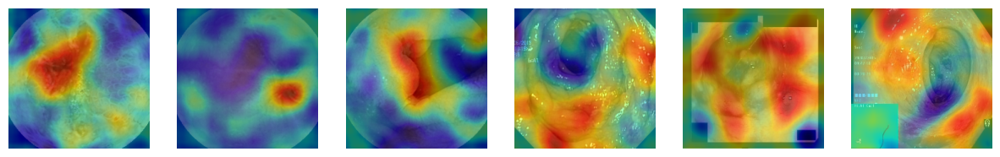

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

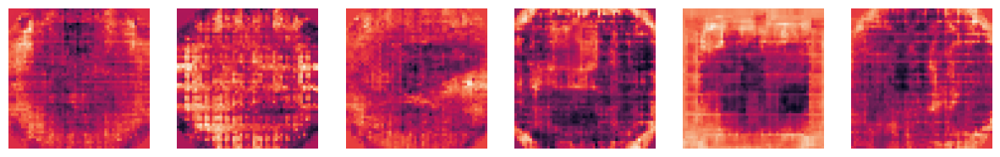

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_s32, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

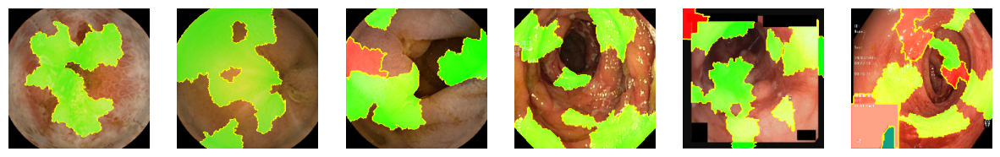

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 372.94it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00, 10.58it/s]


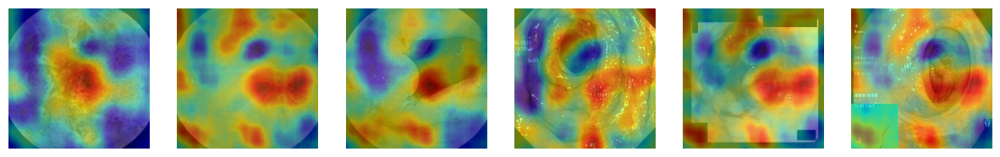

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

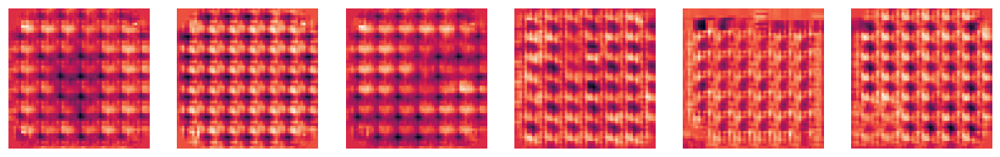

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

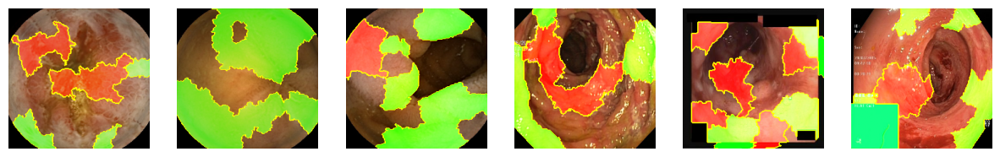

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 375.42it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 11.84it/s]


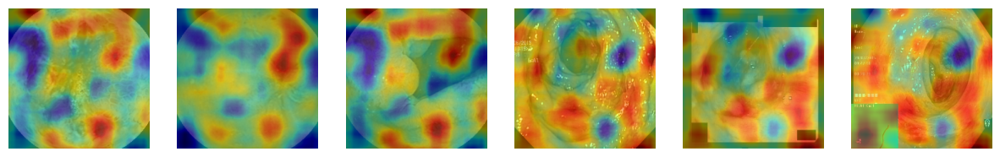

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

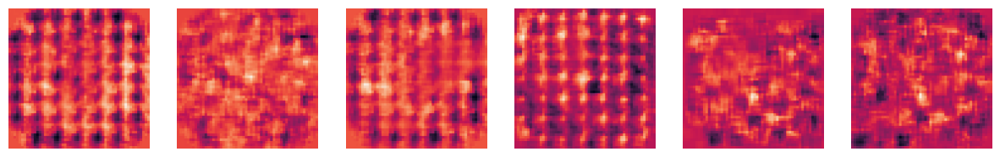

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_B/16

In [ ]:
vit_model_16 = tfimm.create_model("vit_base_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_16_preprocessing = tfimm.create_preprocessing("vit_base_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_16_preprocessing(x)
x = vit_model_16.call(x)
x = layers.Dense(1000, activation="relu")(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_b16 = Model(inputs, outputs)

In [ ]:
model_vit_b16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_b16 = model_vit_b16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 59s 2s/step - loss: 0.1540 - accuracy: 0.9626 - val_loss: 8.2416e-04 - val_accuracy: 1.0000
Epoch 2/200
27/27 [==============================] - 41s 2s/step - loss: 0.0024 - accuracy: 0.9988 - val_loss: 7.8609e-05 - val_accuracy: 1.0000
Epoch 3/200
27/27 [==============================] - 43s 2s/step - loss: 3.4854e-04 - accuracy: 1.0000 - val_loss: 8.1257e-05 - val_accuracy: 1.0000
Epoch 4/200
27/27 [==============================] - 41s 2s/step - loss: 6.5042e-04 - accuracy: 1.0000 - val_loss: 3.5570e-05 - val_accuracy: 1.0000
Epoch 5/200
27/27 [==============================] - 42s 2s/step - loss: 9.5738e-04 - accuracy: 1.0000 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 6/200
27/27 [==============================] - 43s 2s/step - loss: 2.7327e-04 - accuracy: 1.0000 - val_loss: 7.5757e-05 - val_accuracy: 1.0000


<Axes: >

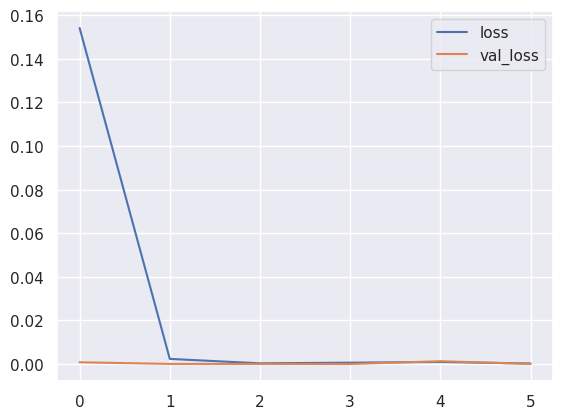

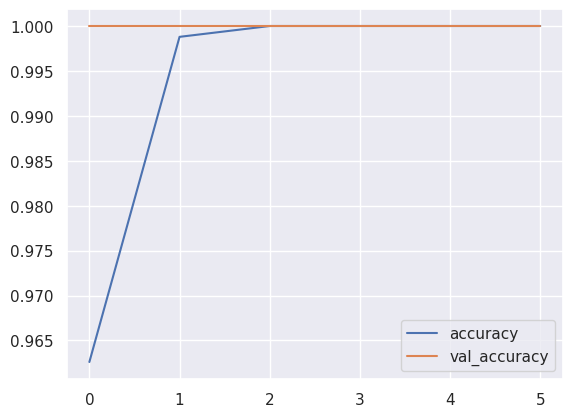

In [ ]:
model_history_b16 = pd.DataFrame(history_b16.history)
model_history_b16.loc[:, ['loss', 'val_loss']].plot()
model_history_b16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_b16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_b16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_b16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_b16['val_loss'].mean()))

Accuracy for Train: 0.9936
Loss for Train: 0.0264
Accuracy for Test: 1.0000
Loss for Test: 0.0004


In [ ]:
start = time.time()
predict_labels_ = model_vit_b16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_b16 = np.argmax(model_vit_b16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_b16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_b16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_b16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_b16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_b16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_b16)))

Accuracy: 1.0000
Loss: 0.0001
Inference Time: 7.41s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


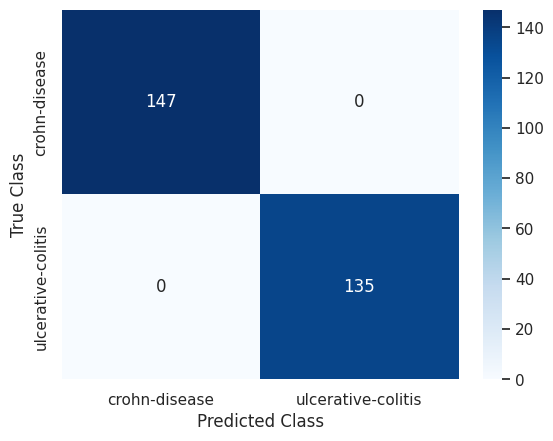

In [ ]:
conf_matrix_b16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_b16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_b16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')


ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ViT = Distiller(student=student_model_2, teacher=model_vit_b16)

distillation_ViT.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history_ViT = distillation_ViT.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 24s 536ms/step - accuracy: 0.5669 - student_loss: 1.3682 - distillation_loss: 28.5590 - val_accuracy: 0.9133 - val_student_loss: 0.1113
Epoch 2/100
27/27 [==============================] - 15s 530ms/step - accuracy: 0.7986 - student_loss: 0.5926 - distillation_loss: 16.4287 - val_accuracy: 0.8376 - val_student_loss: 0.1892
Epoch 3/100
27/27 [==============================] - 15s 530ms/step - accuracy: 0.9349 - student_loss: 0.2602 - distillation_loss: 8.8077 - val_accuracy: 0.9723 - val_student_loss: 1.7959e-05
Epoch 4/100
27/27 [==============================] - 15s 523ms/step - accuracy: 0.9650 - student_loss: 0.1489 - distillation_loss: 7.1179 - val_accuracy: 0.9815 - val_student_loss: 2.1298e-06
Epoch 5/100
27/27 [==============================] - 15s 537ms/step - accuracy: 0.9626 - student_loss: 0.1377 - distillation_loss: 6.0760 - val_accuracy: 0.9926 - val_student_loss: 3.8942e-07
Epoch 6/100
27/27 [===========================

<Axes: >

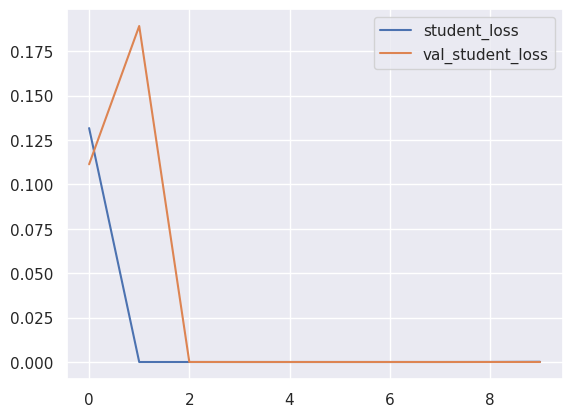

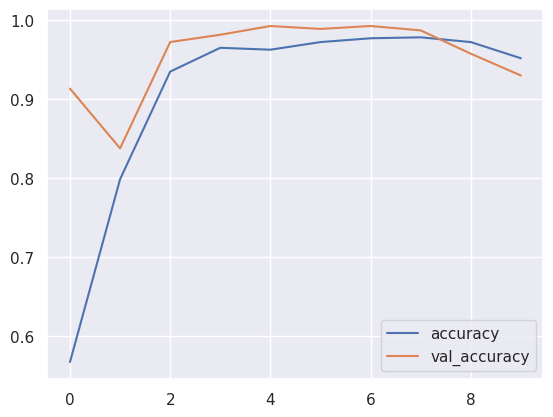

In [ ]:
distiller_history = pd.DataFrame(distillation_history_ViT.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9080
Loss for Train: 0.0132
Accuracy for Test: 0.9554
Loss for Test: 0.0301


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_ViT.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_ViT.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9397
Loss: 0.4739
Inference Time: 2.10s
Precision: 0.8882
Recall: 1.0000
F1-Score: 0.9408
AUC: 0.9422
MCC: 0.8863


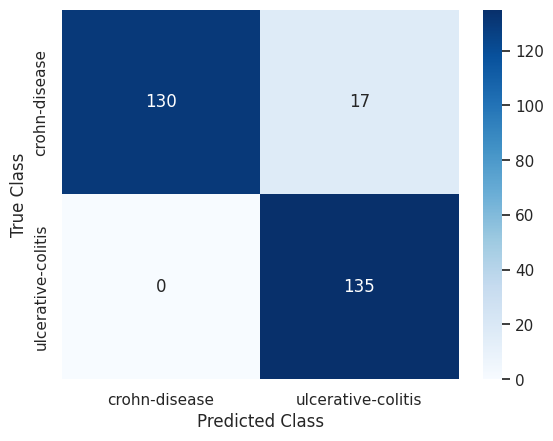

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_ViT.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 54s 804ms/step - accuracy: 0.5090 - student_loss: 0.8977 - distillation_loss: 0.7963 - val_accuracy: 0.7214 - val_student_loss: 0.6744 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 43s 776ms/step - accuracy: 0.5127 - student_loss: 0.8038 - distillation_loss: 0.7768 - val_accuracy: 0.8524 - val_student_loss: 0.6378 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 41s 762ms/step - accuracy: 0.5688 - student_loss: 0.7633 - distillation_loss: 0.7471 - val_accuracy: 0.8653 - val_student_loss: 0.6058 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 43s 784ms/step - accuracy: 0.6055 - student_loss: 0.7124 - distillation_loss: 0.7178 - val_accuracy: 0.8358 - val_student_loss: 0.5792 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 43s 801ms/step - accuracy: 0.6291 - student_loss: 0

<Axes: >

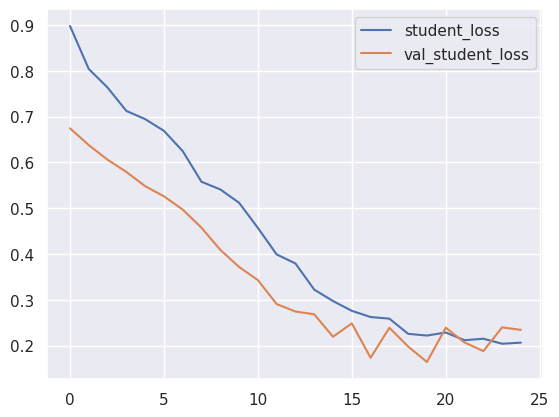

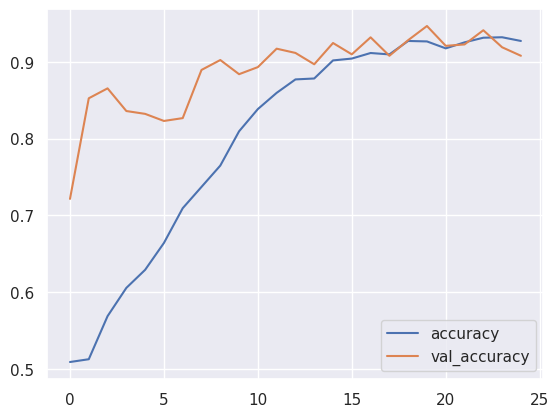

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8030
Loss for Train: 0.4377
Accuracy for Test: 0.8883
Loss for Test: 0.3534


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9149
Loss: 0.2850
Inference Time: 1.32s
Precision: 0.9826
Recall: 0.8370
F1-Score: 0.9040
AUC: 0.9117
MCC: 0.8370


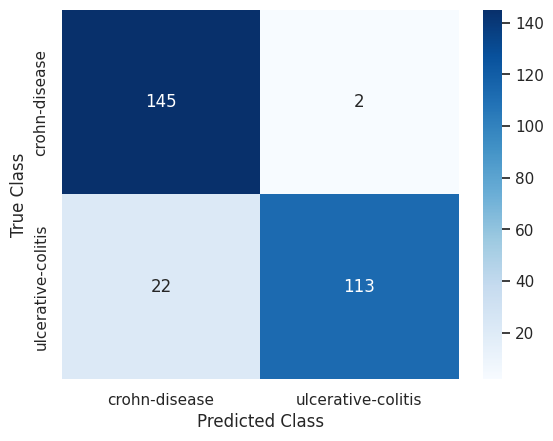

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

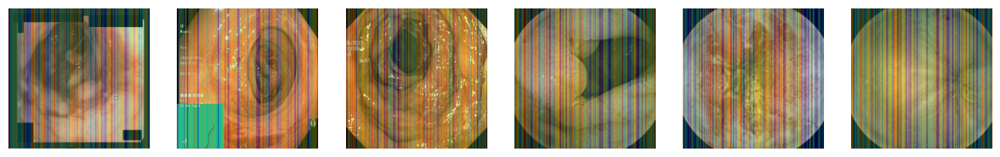

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2[:6], axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b16.layers[-1].activation = None

  preds = model_vit_b16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_b16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

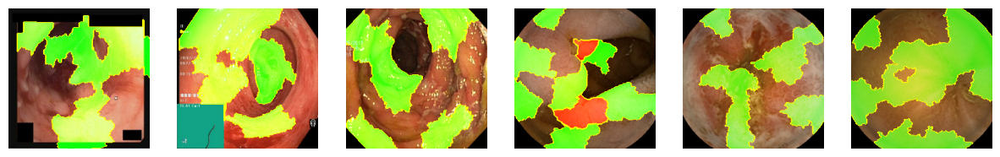

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


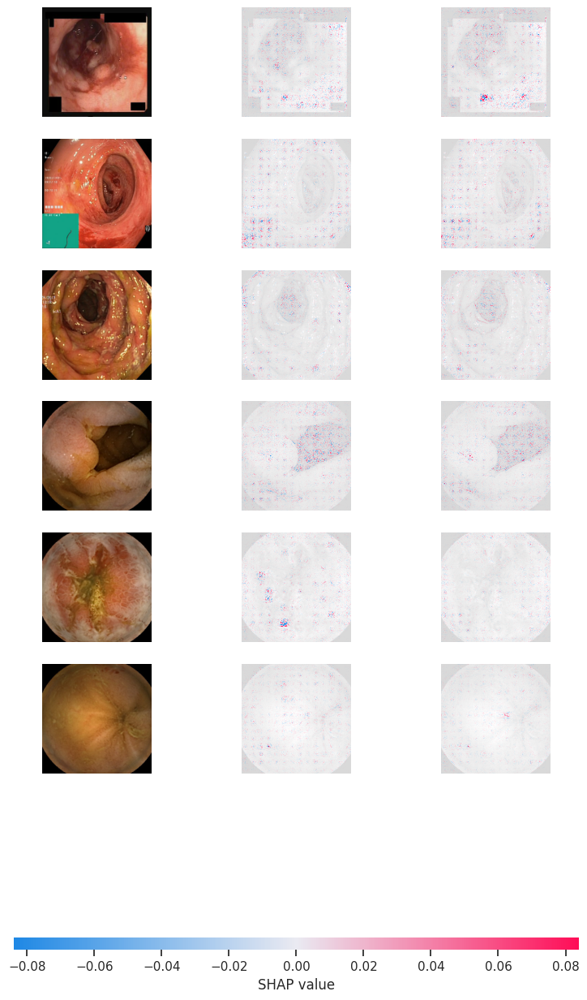

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b16, images_train_1).shap_values(image_interpretability_2)
shap.image_plot(shap_values, image_interpretability_2)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 314.71it/s]


Explaining: 100%|██████████| 32/32 [00:18<00:00,  1.74it/s]


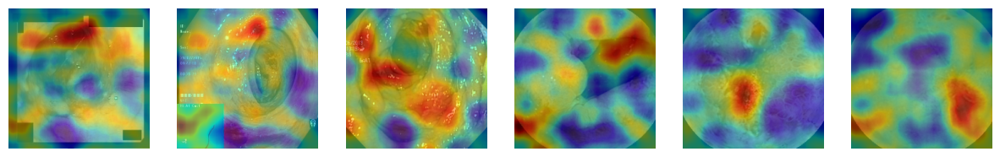

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

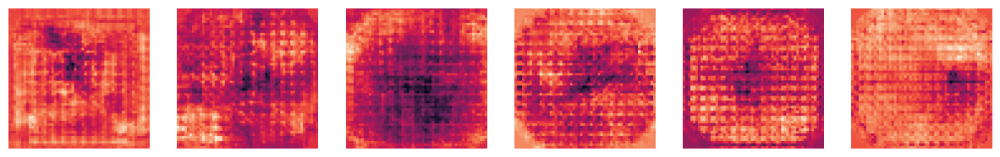

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_b16, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

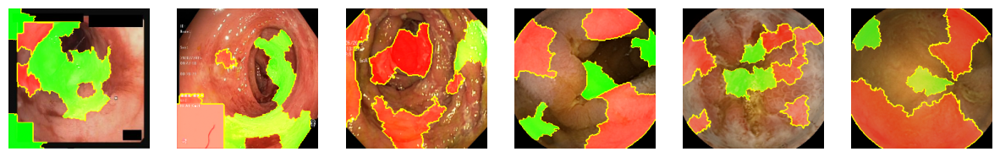

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 331.67it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  7.68it/s]


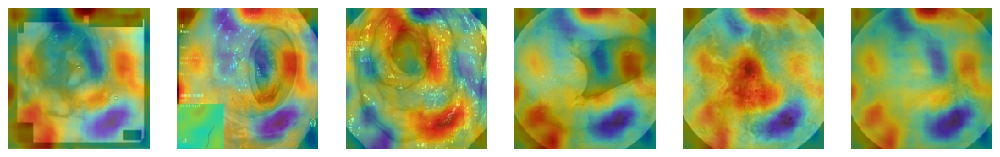

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

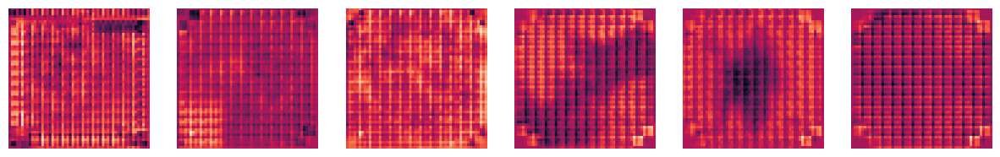

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

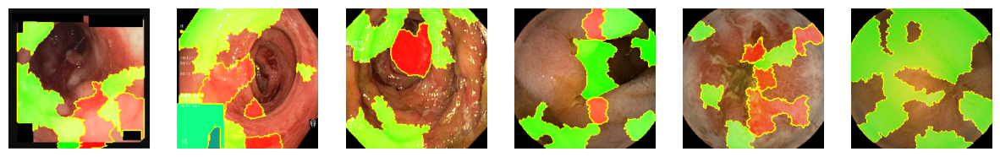

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1,6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_ViT.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_ViT, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 228.00it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.56it/s]


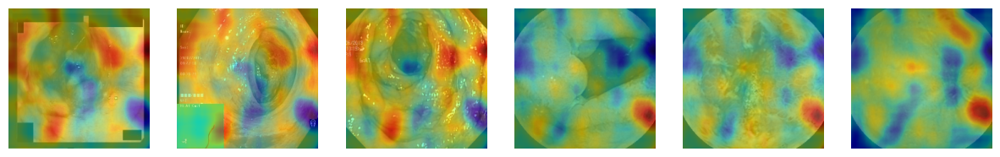

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivy</h3>

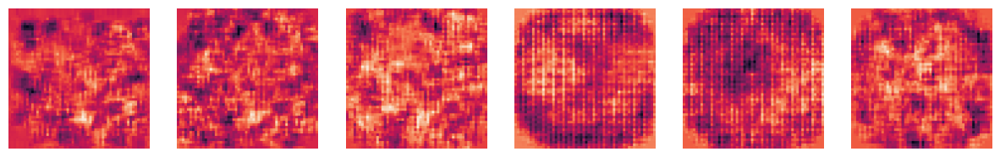

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_ViT, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/16

In [ ]:
vit_model_s16 = tfimm.create_model("vit_small_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_s16_preprocessing = tfimm.create_preprocessing("vit_small_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s16_preprocessing(x)
x = vit_model_s16.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s16 = Model(inputs, outputs)

In [ ]:
model_vit_s16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s16 = model_vit_s16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 34s 701ms/step - loss: 0.3696 - accuracy: 0.8866 - val_loss: 0.0099 - val_accuracy: 1.0000
Epoch 2/200
27/27 [==============================] - 17s 601ms/step - loss: 0.0112 - accuracy: 0.9952 - val_loss: 0.0074 - val_accuracy: 0.9982
Epoch 3/200
27/27 [==============================] - 17s 606ms/step - loss: 0.0028 - accuracy: 0.9988 - val_loss: 0.0072 - val_accuracy: 0.9982
Epoch 4/200
27/27 [==============================] - 17s 608ms/step - loss: 0.0040 - accuracy: 0.9976 - val_loss: 0.0060 - val_accuracy: 0.9982
Epoch 5/200
27/27 [==============================] - 16s 594ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 0.9982
Epoch 6/200
27/27 [==============================] - 16s 596ms/step - loss: 5.0808e-04 - accuracy: 1.0000 - val_loss: 0.0067 - val_accuracy: 0.9982


<Axes: >

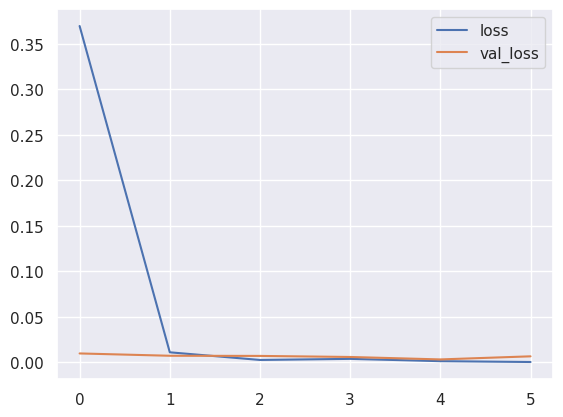

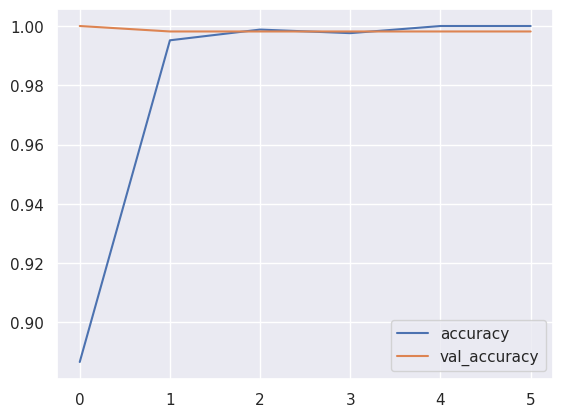

In [ ]:
model_history_s16 = pd.DataFrame(history_s16.history)
model_history_s16.loc[:, ['loss', 'val_loss']].plot()
model_history_s16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s16['val_loss'].mean()))

Accuracy for Train: 0.9797
Loss for Train: 0.0649
Accuracy for Test: 0.9985
Loss for Test: 0.0068


In [ ]:
start = time.time()
predict_labels_ = model_vit_s16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s16 = np.argmax(model_vit_s16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s16)))

Accuracy: 0.9965
Loss: 0.0075
Inference Time: 4.31s
Precision: 0.9926
Recall: 1.0000
F1-Score: 0.9963
AUC: 0.9966
MCC: 0.9929


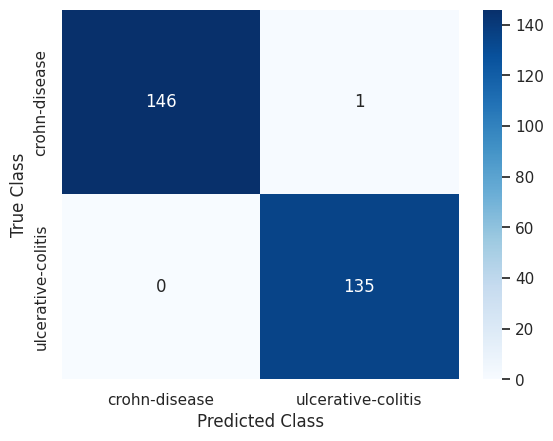

In [ ]:
conf_matrix_s16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 18s 334ms/step - accuracy: 0.5766 - student_loss: 1.2400 - distillation_loss: 14.2882 - val_accuracy: 0.8782 - val_student_loss: 0.0199
Epoch 2/100
27/27 [==============================] - 8s 286ms/step - accuracy: 0.8685 - student_loss: 0.3717 - distillation_loss: 6.8467 - val_accuracy: 0.8616 - val_student_loss: 0.3081
Epoch 3/100
27/27 [==============================] - 9s 309ms/step - accuracy: 0.9071 - student_loss: 0.2809 - distillation_loss: 5.1103 - val_accuracy: 0.9797 - val_student_loss: 6.8774e-04
Epoch 4/100
27/27 [==============================] - 7s 256ms/step - accuracy: 0.9445 - student_loss: 0.1783 - distillation_loss: 3.8957 - val_accuracy: 0.9742 - val_student_loss: 3.5530e-04
Epoch 5/100
27/27 [==============================] - 9s 313ms/step - accuracy: 0.9578 - student_loss: 0.1136 - distillation_loss: 3.7261 - val_accuracy: 0.9779 - val_student_loss: 3.5201e-04
Epoch 6/100
27/27 [==============================] 

<Axes: >

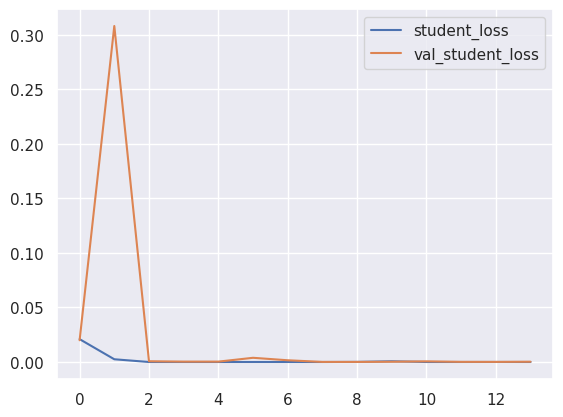

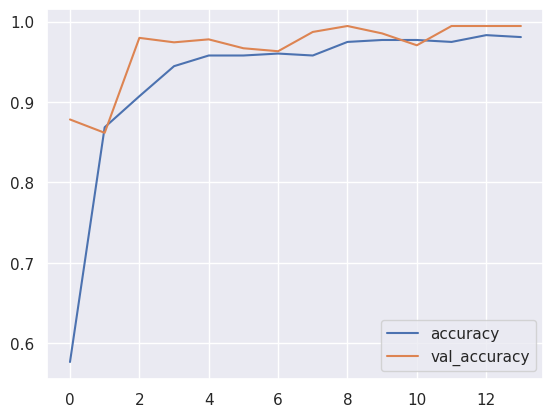

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9284
Loss for Train: 0.0017
Accuracy for Test: 0.9659
Loss for Test: 0.0240


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9894
Loss: 0.0406
Inference Time: 1.61s
Precision: 0.9925
Recall: 0.9852
F1-Score: 0.9888
AUC: 0.9892
MCC: 0.9787


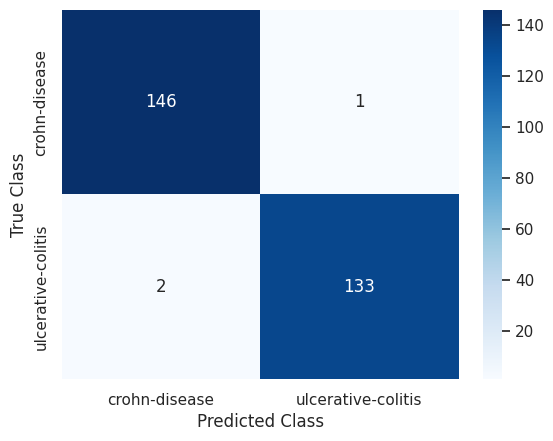

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 38s 534ms/step - accuracy: 0.5103 - student_loss: 1.3141 - distillation_loss: 0.8055 - val_accuracy: 0.5277 - val_student_loss: 0.6326 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 30s 549ms/step - accuracy: 0.5579 - student_loss: 0.7800 - distillation_loss: 0.7543 - val_accuracy: 0.5369 - val_student_loss: 0.6317 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 28s 514ms/step - accuracy: 0.5796 - student_loss: 0.7562 - distillation_loss: 0.7627 - val_accuracy: 0.5683 - val_student_loss: 0.5936 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 28s 516ms/step - accuracy: 0.5983 - student_loss: 0.7513 - distillation_loss: 0.7153 - val_accuracy: 0.6771 - val_student_loss: 0.5715 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 30s 550ms/step - accuracy: 0.6285 - student_loss: 0

<Axes: >

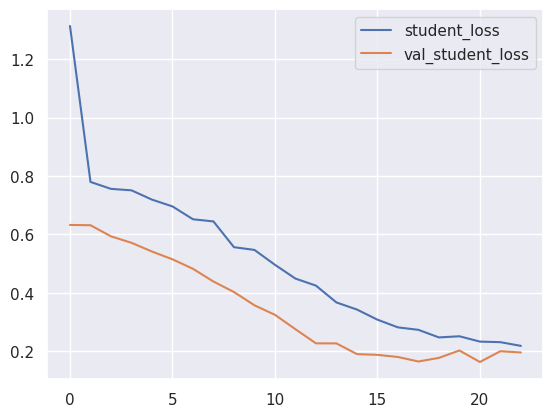

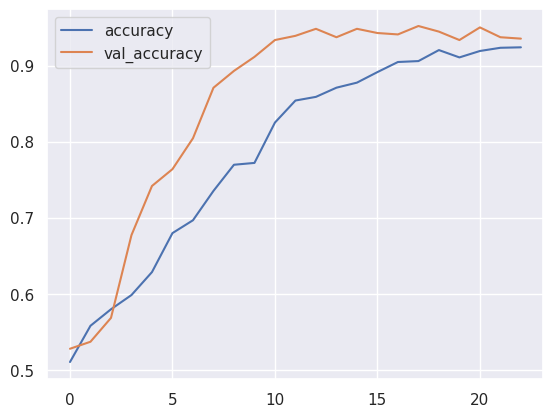

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7876
Loss for Train: 0.5019
Accuracy for Test: 0.8495
Loss for Test: 0.3428


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9255
Loss: 0.2518
Inference Time: 1.40s
Precision: 0.9750
Recall: 0.8667
F1-Score: 0.9176
AUC: 0.9231
MCC: 0.8550


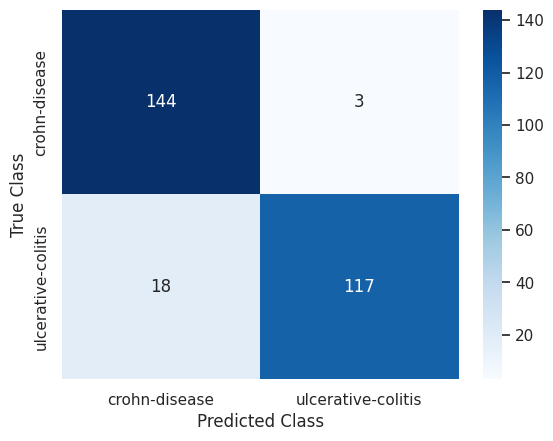

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

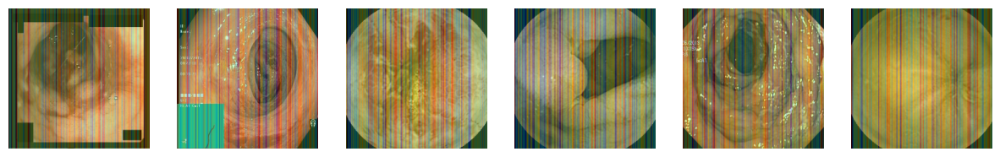

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s16.layers[-1].activation = None

  preds = model_vit_s16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

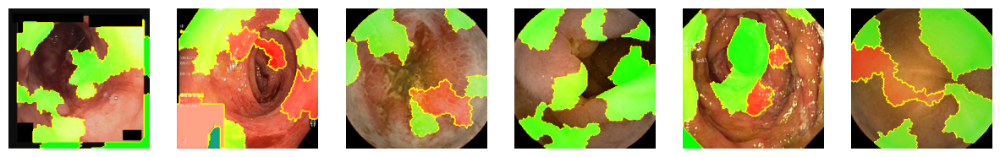

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


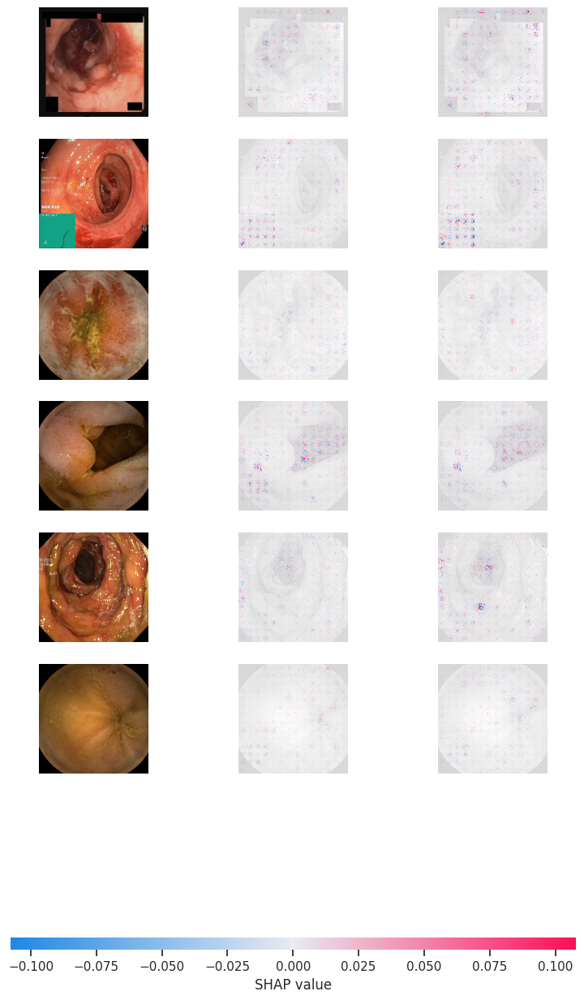

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s16, images_train_1).shap_values(image_interpretability_2)
shap.image_plot(shap_values, image_interpretability_2)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 376.12it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s]


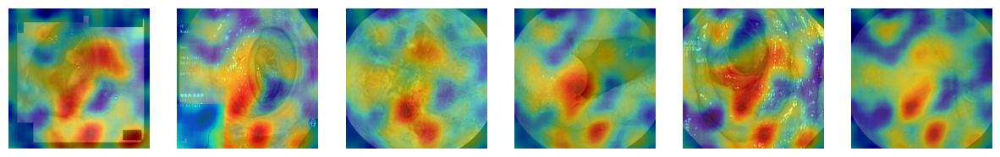

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

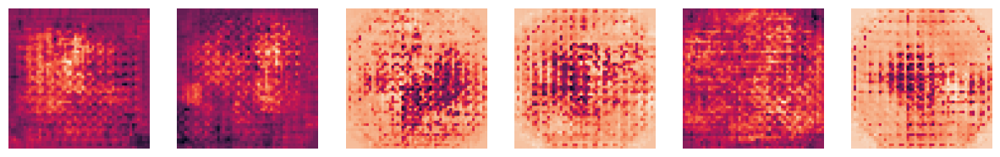

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_s16, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

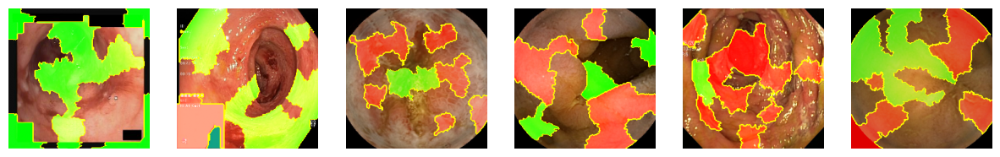

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 385.32it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.74it/s]


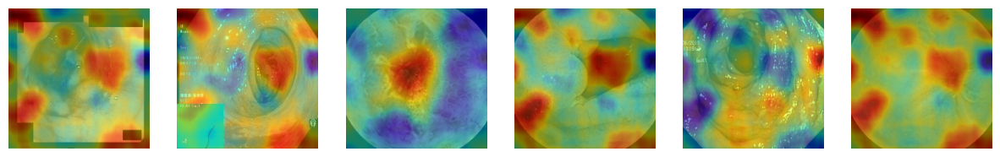

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

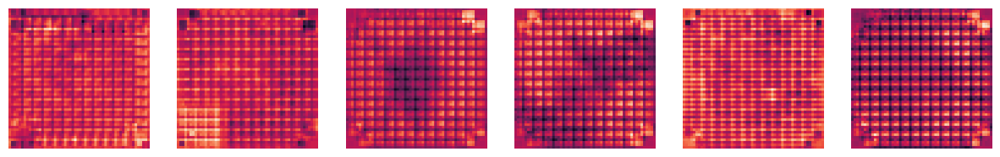

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

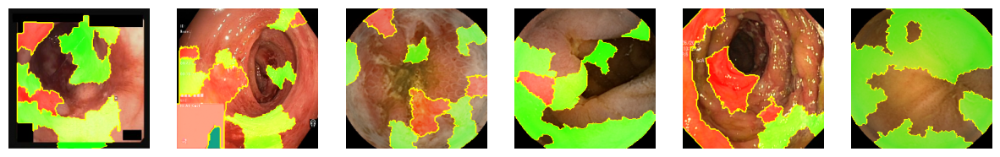

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 255.17it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.41it/s]


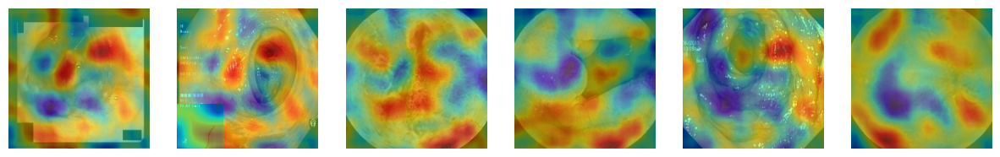

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

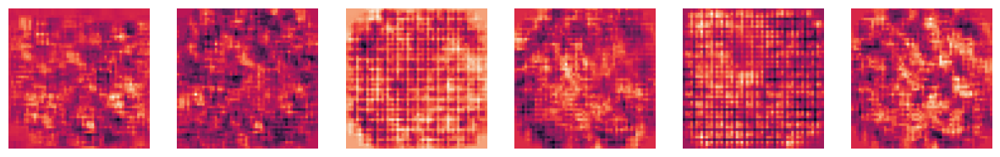

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# R26+S/32

In [12]:
vit_model_hybrid_s32 = tfimm.create_model("vit_small_r26_s32_224_in21k", pretrained=True, nb_classes=0)
vit_model_hybrid_s32_preprocessing = tfimm.create_preprocessing("vit_small_r26_s32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_hybrid_s32_preprocessing(x)
x = vit_model_hybrid_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_hybrid_s32 = Model(inputs, outputs)

In [13]:
model_vit_hybrid_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [14]:
model_vit_hybrid_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [15]:
history_hybrid_s32 = model_vit_hybrid_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
27/27 [==============================] - 61s 1s/step - loss: 0.0808 - accuracy: 0.9686 - val_loss: 0.0402 - val_accuracy: 0.9852
Epoch 2/200
27/27 [==============================] - 19s 708ms/step - loss: 0.0072 - accuracy: 0.9988 - val_loss: 0.0027 - val_accuracy: 1.0000
Epoch 3/200
27/27 [==============================] - 19s 706ms/step - loss: 8.3616e-04 - accuracy: 1.0000 - val_loss: 0.0037 - val_accuracy: 1.0000
Epoch 4/200
27/27 [==============================] - 19s 704ms/step - loss: 5.3799e-04 - accuracy: 1.0000 - val_loss: 0.0068 - val_accuracy: 1.0000
Epoch 5/200
27/27 [==============================] - 20s 718ms/step - loss: 7.4692e-04 - accuracy: 1.0000 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 6/200
27/27 [==============================] - 20s 730ms/step - loss: 7.3005e-04 - accuracy: 1.0000 - val_loss: 0.0070 - val_accuracy: 1.0000
Epoch 7/200
27/27 [==============================] - 20s 716ms/step - loss: 3.3481e-04 - accuracy: 1.0000 - val_loss: 0.004

<Axes: >

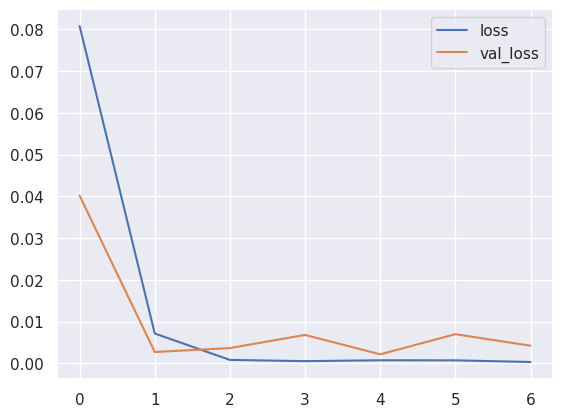

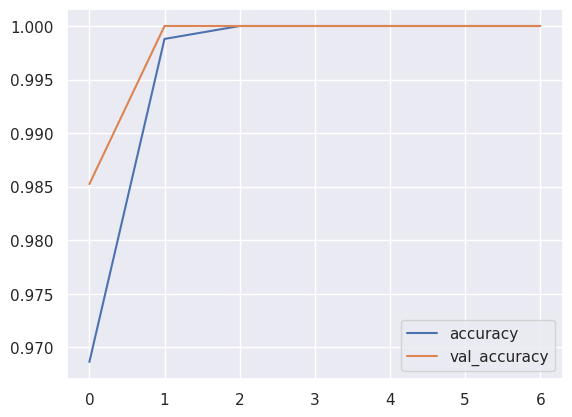

In [16]:
model_history_hybrid_s32 = pd.DataFrame(history_hybrid_s32.history)
model_history_hybrid_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [17]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_s32['val_loss'].mean()))

Accuracy for Train: 0.9953
Loss for Train: 0.0130
Accuracy for Test: 0.9979
Loss for Test: 0.0095


In [18]:
start = time.time()
predict_labels_ = model_vit_hybrid_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_s32 = np.argmax(model_vit_hybrid_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_s32)))

Accuracy: 1.0000
Loss: 0.0059
Inference Time: 8.16s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


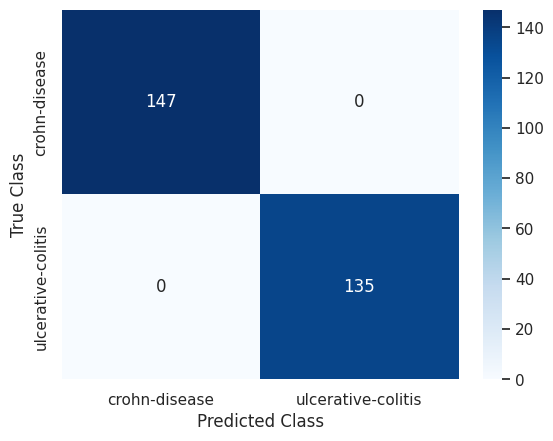

In [19]:
conf_matrix_hybrid_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_hybrid_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [20]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_hybrid_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [21]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_hybrid_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [22]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
27/27 [==============================] - 23s 305ms/step - accuracy: 0.5440 - student_loss: 1.3019 - distillation_loss: 13.7574 - val_accuracy: 0.7657 - val_student_loss: 0.5584
Epoch 2/100
27/27 [==============================] - 9s 321ms/step - accuracy: 0.5645 - student_loss: 1.1196 - distillation_loss: 12.9533 - val_accuracy: 0.6328 - val_student_loss: 0.3004
Epoch 3/100
27/27 [==============================] - 9s 310ms/step - accuracy: 0.5995 - student_loss: 1.2179 - distillation_loss: 12.5875 - val_accuracy: 0.6347 - val_student_loss: 0.1346
Epoch 4/100
27/27 [==============================] - 9s 300ms/step - accuracy: 0.6936 - student_loss: 0.7693 - distillation_loss: 10.1274 - val_accuracy: 0.9299 - val_student_loss: 0.1300
Epoch 5/100
27/27 [==============================] - 10s 348ms/step - accuracy: 0.8528 - student_loss: 0.4447 - distillation_loss: 5.5901 - val_accuracy: 0.8487 - val_student_loss: 3.4869e-04
Epoch 6/100
27/27 [==============================] - 8s

<Axes: >

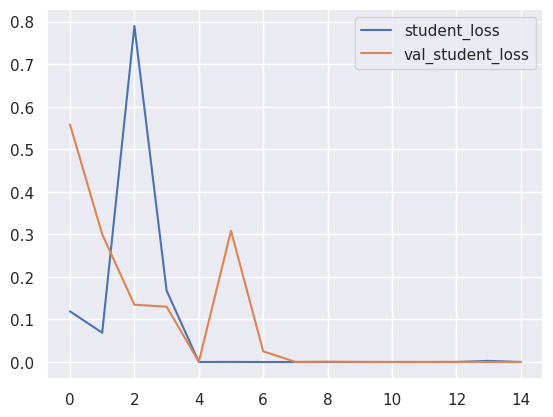

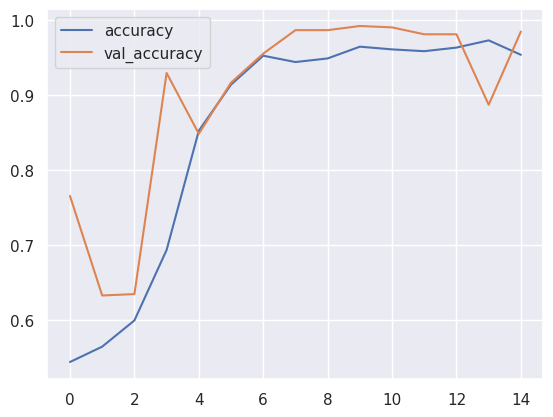

In [23]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [24]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8528
Loss for Train: 0.0766
Accuracy for Test: 0.8985
Loss for Test: 0.0973


In [25]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9858
Loss: 0.0508
Inference Time: 1.55s
Precision: 0.9925
Recall: 0.9778
F1-Score: 0.9851
AUC: 0.9855
MCC: 0.9717


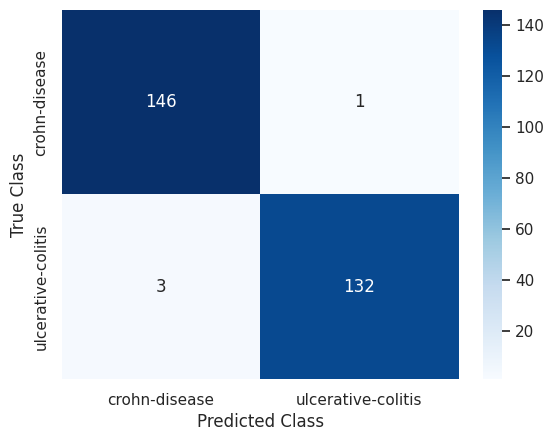

In [26]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [27]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [28]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [29]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_hybrid_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [30]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
54/54 [==============================] - 39s 499ms/step - accuracy: 0.4958 - student_loss: 0.8916 - distillation_loss: 1.0349 - val_accuracy: 0.8358 - val_student_loss: 0.6326 - val_distillation_loss: 0.0000e+00
Epoch 2/100
54/54 [==============================] - 28s 516ms/step - accuracy: 0.5748 - student_loss: 0.7746 - distillation_loss: 0.8202 - val_accuracy: 0.9041 - val_student_loss: 0.5844 - val_distillation_loss: 0.0000e+00
Epoch 3/100
54/54 [==============================] - 27s 481ms/step - accuracy: 0.6116 - student_loss: 0.7248 - distillation_loss: 0.7372 - val_accuracy: 0.9373 - val_student_loss: 0.5373 - val_distillation_loss: 0.0000e+00
Epoch 4/100
54/54 [==============================] - 28s 514ms/step - accuracy: 0.6562 - student_loss: 0.6725 - distillation_loss: 0.6746 - val_accuracy: 0.9244 - val_student_loss: 0.4794 - val_distillation_loss: 0.0000e+00
Epoch 5/100
54/54 [==============================] - 26s 476ms/step - accuracy: 0.7159 - student_loss: 0

<Axes: >

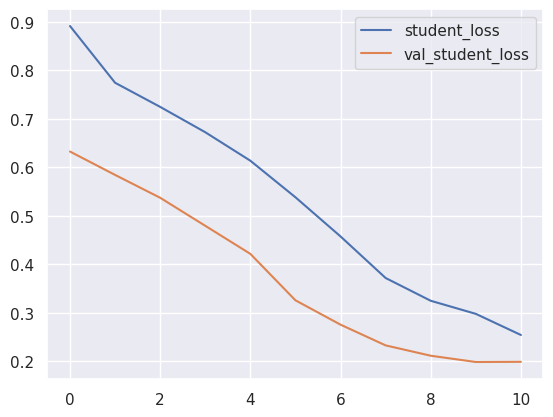

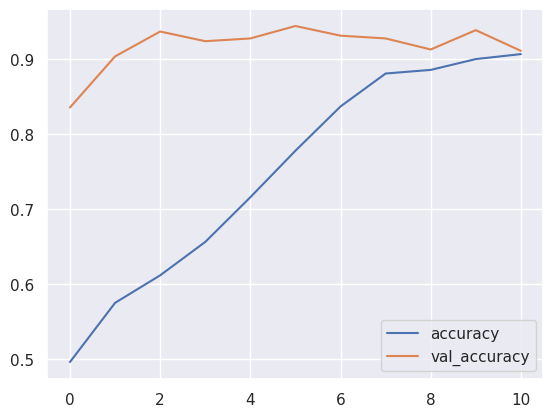

In [31]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [32]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7495
Loss for Train: 0.5383
Accuracy for Test: 0.9180
Loss for Test: 0.3725


In [33]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9078
Loss: 0.2604
Inference Time: 1.59s
Precision: 0.9739
Recall: 0.8296
F1-Score: 0.8960
AUC: 0.9046
MCC: 0.8226


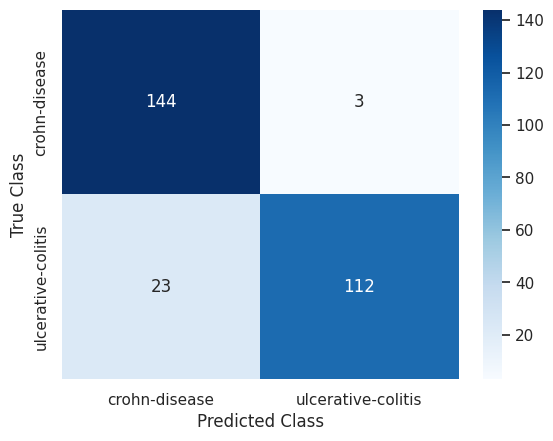

In [34]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [35]:
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

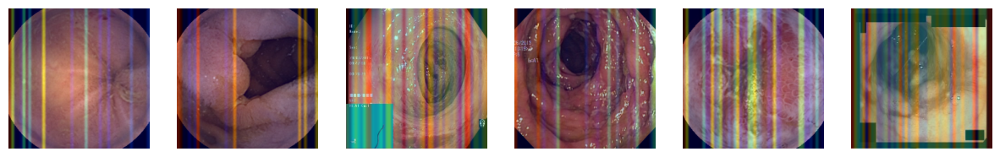

In [36]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_hybrid_s32.layers[-1].activation = None

  preds = model_vit_hybrid_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_hybrid_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

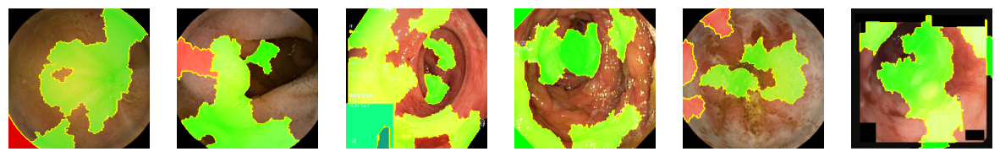

In [37]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_hybrid_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


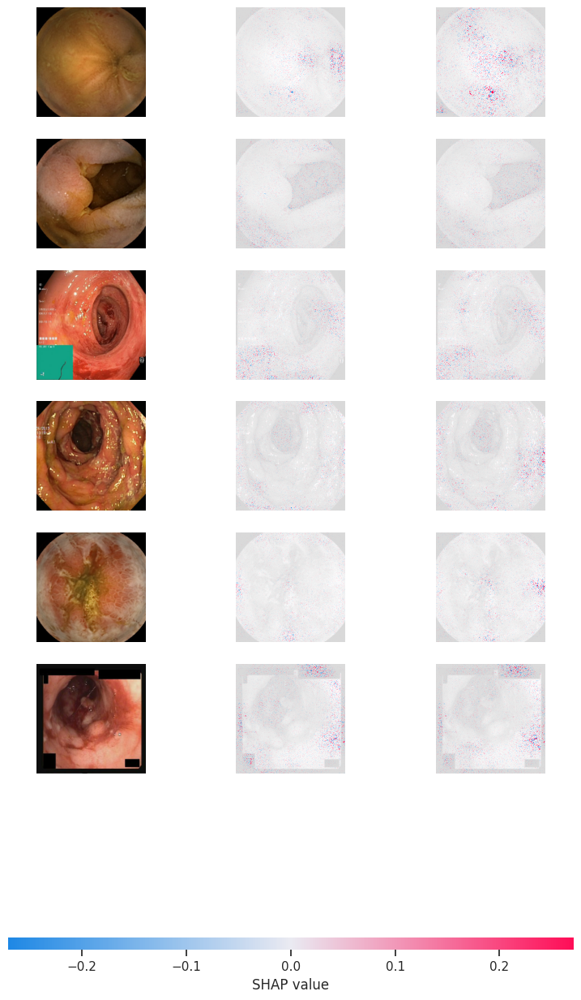

In [38]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_hybrid_s32, images_train_1).shap_values(image_interpretability_2)
shap.image_plot(shap_values, image_interpretability_2)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [39]:
model_rise = RISE(1000, 8, 0.5, model_vit_hybrid_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 355.21it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s]


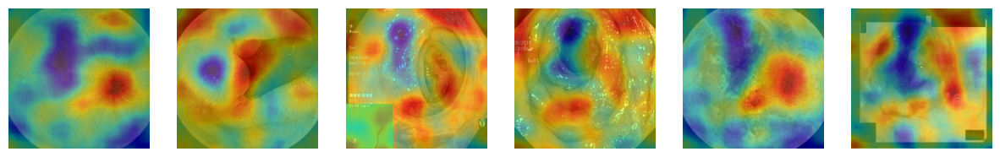

In [40]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

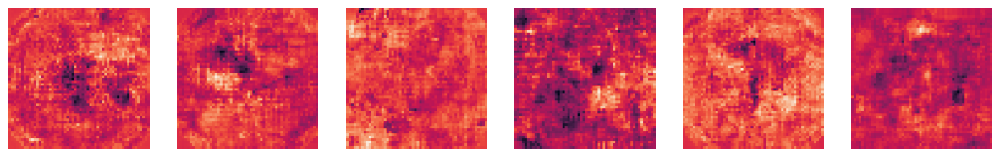

In [41]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_hybrid_s32, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

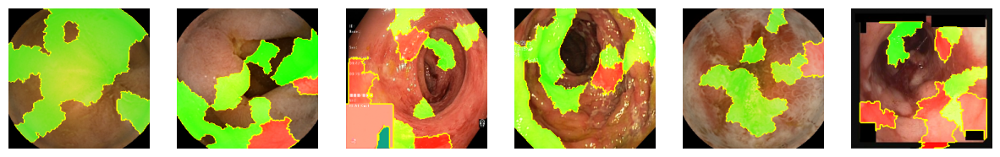

In [42]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [43]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 225.87it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.59it/s]


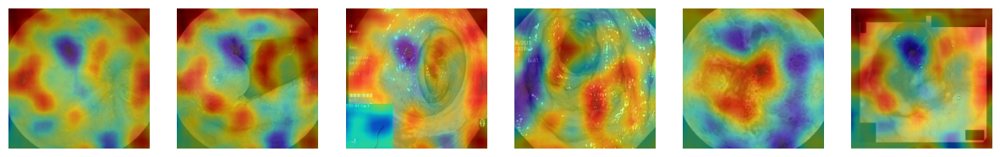

In [44]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

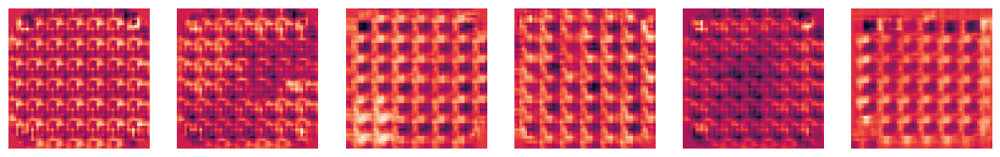

In [45]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

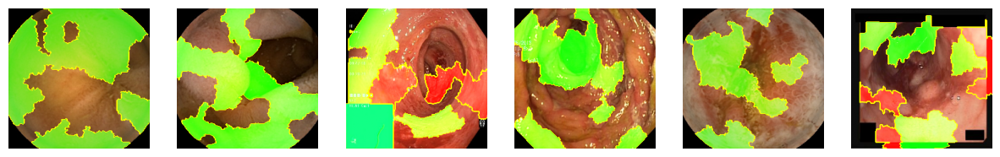

In [46]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [47]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:05<00:00, 196.89it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.39it/s]


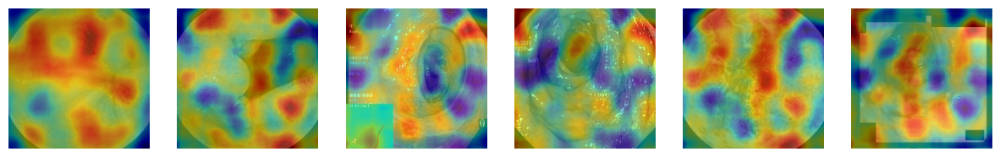

In [48]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_2[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

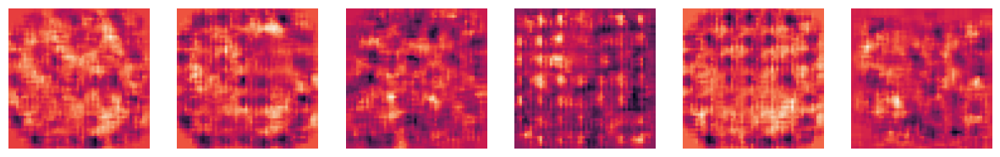

In [49]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_2, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_2[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1